<a href="https://colab.research.google.com/github/brayden10/cse380-notebooks/blob/master/10_2_Ponder_and_Prove_Spanning_Trees.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Ponder and Prove Spanning Trees
## Due: Saturday, 13 March 2021, 11:59 pm

In [2]:
!pip install graphviz
!pip install networkx

In [3]:
import os
os.path.abspath(os.getcwd())

'/content'

## The Goal

The goal of this assignment is to investigate spanning trees of graphs.

Here is the example spanning tree you saw in your DPC:

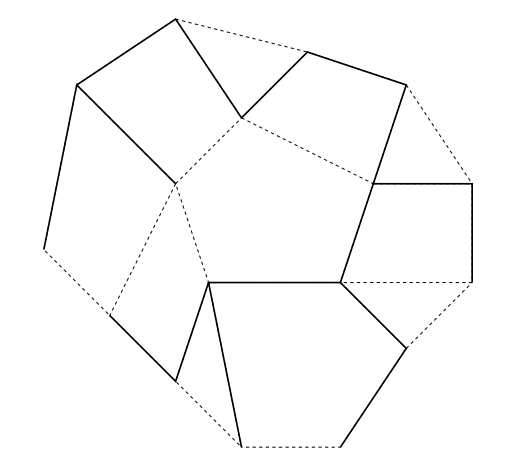

Wikipedia has a [Spanning Tree](https://en.wikipedia.org/wiki/Spanning_tree) page with useful information.

## Algorithm to Find a Spanning Tree

In five pseudocode steps:
1. Start with the "frontier" being a list of size one --- containing just the first node.
2. Pick a link connected to a node in the frontier that does not create a cycle --- that is, the other (destination) node of the link is not already in the frontier.
3. Add that destination node to the frontier unless already there.
4. Add the picked link to the spanning-tree.
5. Repeat steps 2-4 until all nodes are in the frontier.

## What to Create

1. A graph representation --- a way to represent both nodes and links.
2. A function that takes a graph and returns a list of its nodes.
3. A function that takes a graph and returns a list of its links.
4. A function that takes a graph and returns an adjacency list of nodes and links.
5. A function that takes a graph and a node and returns a list of adjacent nodes to that node.

In [4]:
graph = {'a' : ['b', 'c'], 'b' : ['a', 'd'], 'c' : ['a', 'd'], 'd' : ['b', 'c']}

In [5]:
def get_nodes(graph):
  return [*graph]

In [6]:
def get_links(graph):
  frozen = set([frozenset(tuple(set([k, v]))) for k in get_nodes(graph) for v in graph[k]])
  return [tuple(x) for x in frozen]

In [7]:
def adj_list(graph):
  return graph 
#[[k,v] for k,v in graph.items()]

In [8]:
def get_adj_nodes(graph, node):
  return graph[node]

In [9]:
print(get_nodes(graph))

['a', 'b', 'c', 'd']


In [10]:
print(get_links(graph))

[('b', 'a'), ('b', 'd'), ('c', 'a'), ('c', 'd')]


In [11]:
print(adj_list(graph))

{'a': ['b', 'c'], 'b': ['a', 'd'], 'c': ['a', 'd'], 'd': ['b', 'c']}


In [12]:
print(get_adj_nodes(graph, 'a'))

['b', 'c']


In [13]:
new_graph = {'a' : ['c', 'b', 'g'], 'b' : ['a', 'f', 'h'], 'c' : ['d', 'e', 'a'], 'd' : ['c'], 'e' : ['c', 'f', 'g'], 'f' : ['b', 'e', 'h'], 'g' : ['a', 'h', 'e'], 'h' : ['f', 'b', 'g']}
ladder_graph = {1 : [2, 5], 2 : [1, 6, 3], 3 : [2, 7, 4], 4 : [3, 8], 5 : [1, 6], 6 : [5, 2, 7], 7 : [6, 3, 8], 8 : [7, 4]}

In [14]:
def gen_spanning_tree(graph, root=None):
  # Step 1
  tree = []
  frontier = []
  if not root:
    root = get_nodes(graph)[0]
  frontier = [root]
  tree = gen_spanning_tree_rec(graph, frontier)
  return build_tree(tree)

def gen_spanning_tree_rec(graph, frontier, tree=[]):
  if set(frontier) == set(get_nodes(graph)):
    return tree
  possible = list(filter(lambda n: (n[1] not in frontier and n[0] in frontier) or (n[0] not in frontier and n[1] in frontier), get_links(graph)))
  return gen_spanning_tree_rec(graph, frontier + [possible[0][0] if possible[0][0] not in frontier else possible[0][1]], tree + [possible[0]])

In [15]:
import networkx as nx 

def gen_random_graph(n, p):
  G= nx.erdos_renyi_graph(n, p)
  return list(G.edges)

In [16]:
gen_random_graph(6, .5)

[(0, 1), (0, 4), (1, 3), (2, 3), (2, 4), (3, 4), (3, 5), (4, 5)]

In [17]:
from graphviz import Graph
from IPython.display import Image, display

# The only thing not functional here is graphviz
def display_graph(graph):
  links = get_links(graph)
  nodes = get_nodes(graph)
  dot = Graph(format='png')
  map(lambda n: dot.node(str(n)), nodes)
  for pair in links:
    dot.edge(str(pair[0]), str(pair[1]))
  #e = list(map(lambda pair: str(pair[0]) + str(pair[1]), links))
  #dot.edges(e)
  dot.render('test-output/graph', view=True)
  display(Image('/content/test-output/graph.png'))

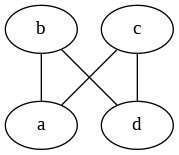

In [18]:
display_graph(graph)

In [19]:

def build_tree(pairs):
  nodes = list(set([x for pair in range(len(pairs)) for x in pairs[pair]]))
  prelim_tree = {key:list(set([links[1] if (links[0] == key and links[1] != key) else links[0] if (links[0] != key and links[1] == key) else '' for links in pairs])) for key in nodes}
  tree = {key:list(filter(lambda x : x != '', prelim_tree[key])) for key in prelim_tree}
  return tree
  

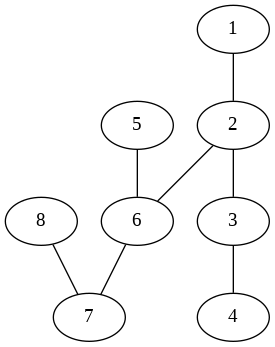

In [20]:
l = [(1, 2), (2, 6), (6, 7), (5, 6), (2, 3), (8, 7), (3, 4)]
new = build_tree(l)
display_graph(new)

## Test Your Code

You will need several different types of graphs (including ladder graphs) with which to test your algorithm.


See the self-assessment for specifics.

In [21]:
# 3 of my own Graphs:
g_1 = build_tree(gen_random_graph(40, 0.7))
g_2 = build_tree(gen_random_graph(23, 1.7))
g_3 = build_tree(gen_random_graph(34, 2.0))

# Graph from the top of the page
graph_top = {'a' : ['c', 'b', 'd'], 'b' : ['a', 'e'], 'c' : ['a', 'f', 'g'], 'd' : ['a', 'e', 'f', 'i' ], 'e' : ['b', 'd', 'h'], 'f' : ['d', 'c', 'g', 'j'], 'g' : ['c', 'f', 'k'], 'h' : ['e', 'i', 'q'], 'i' : ['d', 'h', 'o', 'q'], 'j' : ['f', 'l', 'o', 'k'], 'k' : ['g', 'l', 'j'], 'l' : ['k', 'm', 'j'], 'm' : ['l', 'o', 'n'], 'n' : ['m', 'o', 'p'], 'o' : ['j', 'i', 'n', 'm'], 'p' : ['n', 'q'], 'q': ['p', 'i', 'h']}
# Ladder Graphs:
ladder_graph_2 ={1 : [2, 3], 2 : [1, 4], 3 : [1, 4], 4 : [3, 2]}
ladder_graph_3 = {1 : [2, 4], 2 : [1, 5, 3], 3 : [2, 6], 4 : [1, 5], 5 : [4, 2, 6], 6 : [5, 3]}
ladder_graph_4 = {1 : [2, 5], 2 : [1, 6, 3], 3 : [2, 7, 4], 4 : [3, 8], 5 : [1, 6], 6 : [5, 2, 7], 7 : [6, 3, 8], 8 : [7, 4]}
ladder_graph_5 = {1 : [2, 6], 2 : [1, 3, 7], 3 : [2, 4, 8], 4 : [3, 9, 5], 5 : [4, 10], 6 : [1, 7], 7 : [6, 2, 8], 8 : [7, 3, 9], 9 : [8, 4, 10], 10 : [9, 5]}

### Ladder Graphs

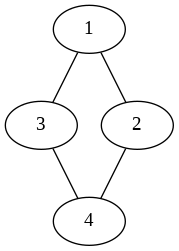

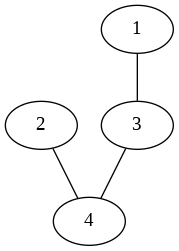

In [22]:
display_graph(ladder_graph_2)
tree = gen_spanning_tree(ladder_graph_2)
display_graph(tree)

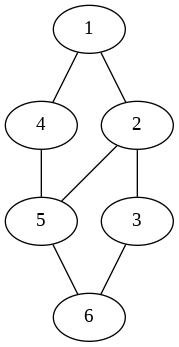

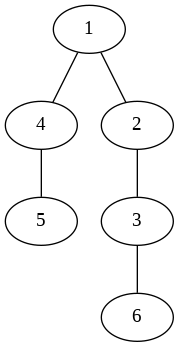

In [23]:
display_graph(ladder_graph_3)
tree = gen_spanning_tree(ladder_graph_3)
display_graph(tree)

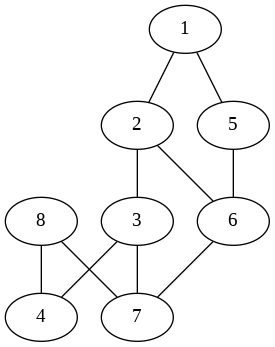

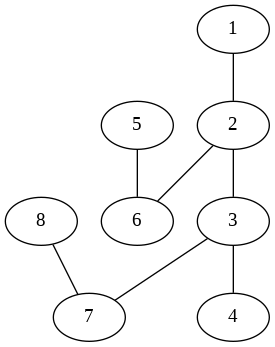

In [24]:
display_graph(ladder_graph_4)
tree = gen_spanning_tree(ladder_graph_4)
display_graph(tree)

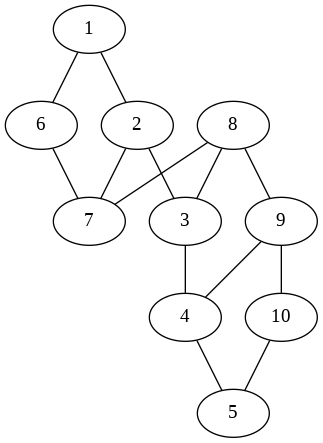

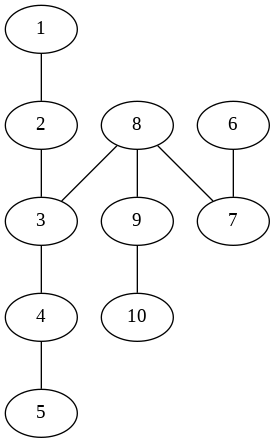

In [25]:
display_graph(ladder_graph_5)
tree = gen_spanning_tree(ladder_graph_5)
display_graph(tree)

### Example Graph

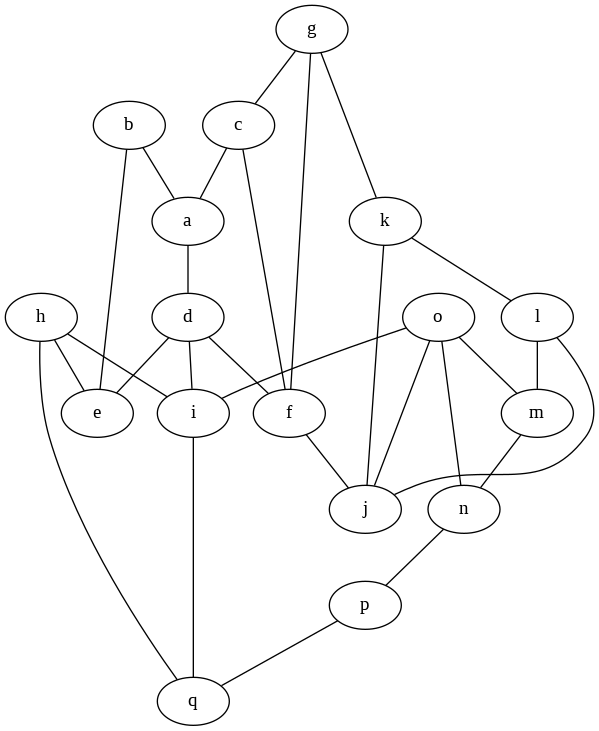

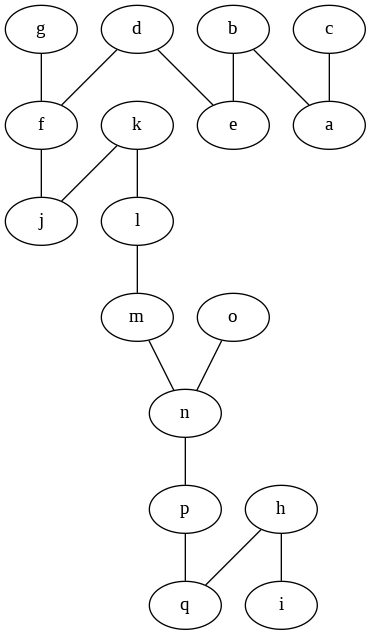

In [26]:
display_graph(graph_top)
tree = gen_spanning_tree(graph_top)
display_graph(tree)

### 3 of my own graphs:

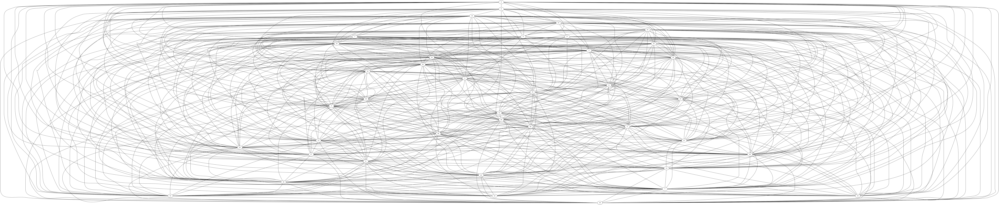

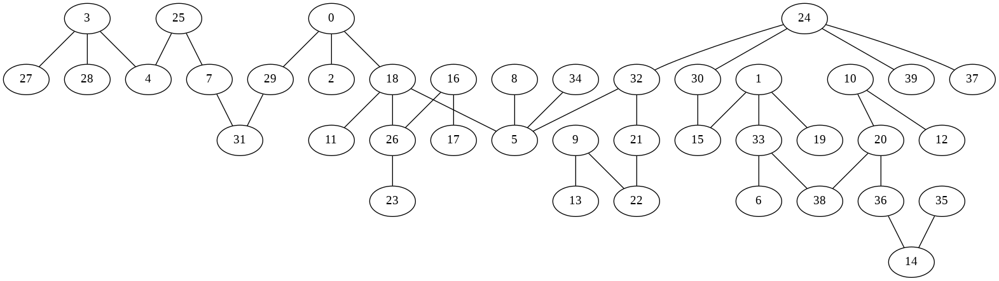

In [27]:
display_graph(g_1)
tree = gen_spanning_tree(g_1)
display_graph(tree)

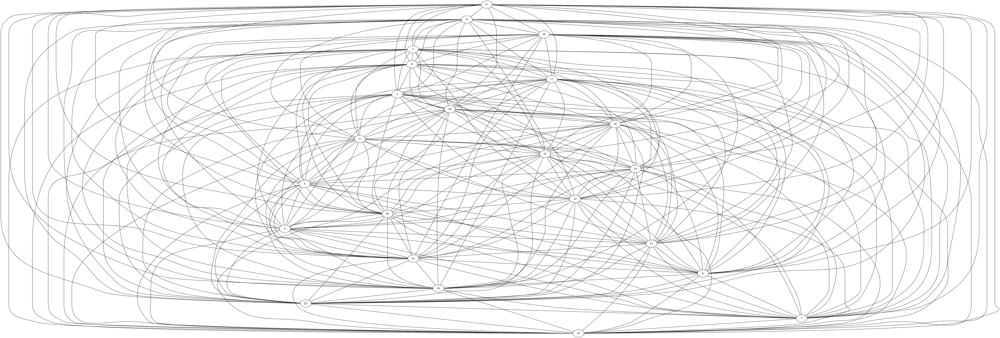

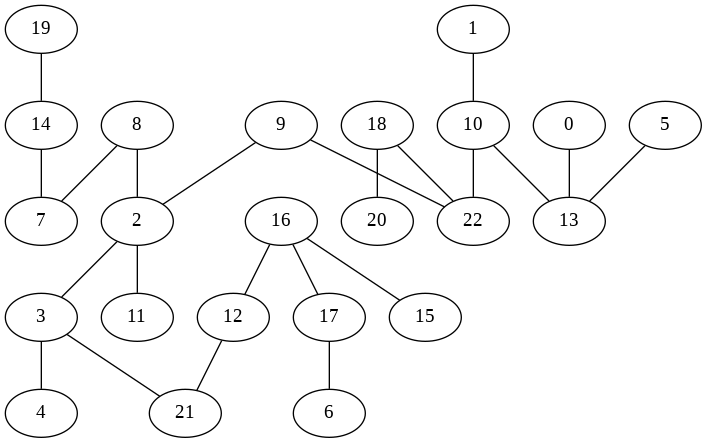

In [28]:
display_graph(g_2)
tree = gen_spanning_tree(g_2)
display_graph(tree)

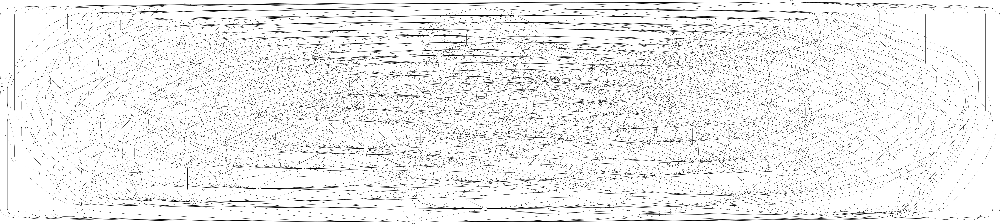

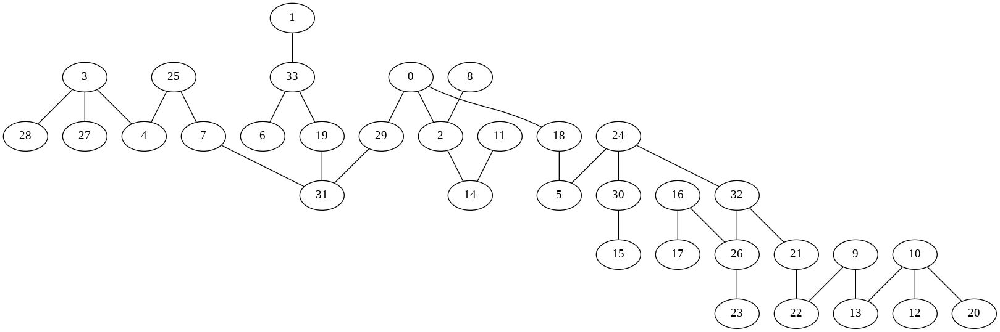

In [29]:
display_graph(g_3)
tree = gen_spanning_tree(g_3)
display_graph(tree)

# My Report on What I Did and What I Learned

## Fun


I had an easier time understanding this weeks PAP when compared to last weeks. I feel i really did have fun trying to find out how to make the tree. Some of the code was beyond me especially since we desided to write all of the code in functional programing. We all worked really hard and in the end we came up with a really good functional program. It seems to me that functional programing is like trying to write one line of code for every three there would normally be in procedural.  

## New

In our group I personally learned a lot of new things. As always my understanding of Python was uplifted and edified in new and interesting ways. I learned that python doesn’t like to have sets of sets but it will accept a set of a frozenset wich makes the set immutable. My entire group also learned a lot about spanning trees, things like how they work and how they are set up. I also learned that python has a * operator that unpacks keys from a dictionary. This discovery made finding the nodes in our dictionary graph much more simple. 

## Meaningful


If I was to say what the most meaningful thing I learned this week was I would say it has to be my new knowledge on how spanning trees work. We used graphs to make pictures of graphs and learned how to change a big graph into a spanning tree. I am sure this knowledge will be useful in the future. 

## Other

I collaborated with Davis Kerr, Matthew Reed, and Paul Samedani. We all worked together to understand the problem and write the code. This makes it difficult to locate specific contributions.<br><br>

We all worked to make the first five code functions. They where not super hard to make although we did have to revise them periodicaly throughout the assignment esspesialy the get_links function. My bigest contribution is to be the person who asks the questions and makes sure that we stay on track. I may not be as code savvy as some of my classmates but I definaltly think that without me things would take a lot longer to be done.  

## Above and Beyond

My group and I wrote all our code in a pure functional style, with the exception of using outside OOP based libraries. We also were able to randomly generate graphs for our 3 tests.

# What is True?
Click on each warranted checkbox to toggle it to True (or back to False). 

NOTE: *This only works in Colab. If you run it in some other Jupyter notebook client/server environment you may have to change False to True (or vice versa) manually.*

This self-assessment is subject to revision by a grader.

In [30]:
#@markdown ## What is True about what I did?
#@markdown ### I had fun.
cb00 = True #@param {type:'boolean'}
#@markdown ### I learned something new.
cb01 = True #@param {type:'boolean'}
#@markdown ### I achieved something meaningful, or something I can build upon at a later time.
cb02 = True #@param {type:'boolean'}
#@markdown ## What is True about my report?
#@markdown ### I wrote a sufficient number of well-written sentences.
cb03 = True #@param {type:'boolean'}
#@markdown ### My report is free of mechanical infelicities.
cb04 = True #@param {type:'boolean'}
#@markdown ### I used Grammarly (or something better described in my report) to check for MIs.
cb05 = True #@param {type:'boolean'}
#@markdown ### I reported on any connections I found between these problems and something I already know. 
cb06 = True #@param {type:'boolean'}
#@markdown ### I reported who were and what contribution each of my collaborators made.
cb07 = True #@param {type:'boolean'}
#@markdown ## What is True about my code?
#@markdown ### I created code to represent a graph as (at a bare minimum) a set of nodes and a set of links.
cb08 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and returns a list of its nodes.
cb09 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and returns a list of its links.
cb10 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and returns an adjacency list of nodes and links.
cb11 = True #@param {type:'boolean'}
#@markdown ### I wrote a function that takes a graph and a node and returns a list of adjacent nodes to that node.
cb12 = True #@param {type:'boolean'}
#@markdown ### I correctly implemented the spanning tree algorithm.
cb13 = True #@param {type:'boolean'}
#@markdown ## What is true about my testing?
#@markdown ### I created a ladder graph with 2 rungs and tested my code on it.
cb14 = True #@param {type:'boolean'}
#@markdown ### I created a ladder graph with 3 rungs and tested my code on it.
cb15 = True #@param {type:'boolean'}
#@markdown ### I created a ladder graph with 4 rungs and tested my code on it.
cb16 = True #@param {type:'boolean'}
#@markdown ### I created a ladder graph with 5 rungs and tested my code on it.
cb17 = True #@param {type:'boolean'}
#@markdown ### I created a graph from the example at the top of this notebook and tested my code on it.
cb18 = True #@param {type:'boolean'}
#@markdown ### I created three larger graphs (each with more than 20 nodes and more than 40 links) of my own devising and tested my code on it.
cb19 = True #@param {type:'boolean'}

## DO NOT CHANGE ANYTHING IN THE NEXT CODE CELL!!
### Delete this cell and the following ones before submitting your work.

In [31]:
points_for_what_I_did = [5]*3
points_for_my_report = [8]*5
points_for_my_code = [5]*6
points_for_my_testing = [2]*4 + [3,4]
points = points_for_what_I_did + points_for_my_report + points_for_my_code + points_for_my_testing
# cb is short for checkbox
total = sum(map(lambda n, p: p if eval(f'cb{n:02}') else 0,
                range(len(points)), points))             
total

96

# For graders

In [32]:
#@markdown ---
number_of_MIs_found = 0 #@param {type: 'slider', min: 0, max: 5}
#@markdown ---
